In [1]:
import pandas as pd
import os
import matplotlib.pyplot as plt
import plotly.express as px

from sklearn.preprocessing import StandardScaler

from sklearn.ensemble               import RandomForestClassifier,ExtraTreesClassifier,GradientBoostingClassifier,AdaBoostClassifier,BaggingClassifier,VotingClassifier,HistGradientBoostingClassifier
from sklearn.multiclass             import OneVsRestClassifier
from sklearn.neighbors              import KNeighborsClassifier
from sklearn.linear_model           import LogisticRegression,Perceptron,PassiveAggressiveClassifier,SGDClassifier
from sklearn.tree                   import DecisionTreeClassifier
from sklearn.svm                    import SVC,NuSVC
from sklearn.discriminant_analysis  import LinearDiscriminantAnalysis,QuadraticDiscriminantAnalysis
from sklearn.naive_bayes            import GaussianNB,BernoulliNB

from sklearn.model_selection import GridSearchCV

from sklearn.metrics import ConfusionMatrixDisplay
from sklearn.metrics import classification_report

In [2]:
def     data_frame(pair_name):
    folder_path=f"C:\\Users\\manch\\OneDrive\\Documents\\dev\\Trading\\Synthetics\\Step_index\\data_files\\labeled"
    file        =   folder_path+f"\\{pair_name}"
    df          =   pd.read_csv(file,sep=' ')
    return df

In [18]:
dfMain=data_frame(pair_name="dfUltimate_Moving Average Trends_STEP_2024_M1_9_3_14_20_28_99999.csv")


In [19]:
y=dfMain["Peak"]

In [20]:
X=dfMain.copy()
X.pop('Trend Change')
X.pop('Slope Trend')
X.pop('Time Stamps')
X.pop('Instance')
X.pop("Peak")

0         rising
1         rising
2          crest
3        falling
4        falling
          ...   
99994    falling
99995    falling
99996    falling
99997    falling
99998    falling
Name: Peak, Length: 99999, dtype: object

In [21]:
scaler = StandardScaler()
X_svc =scaler.fit_transform(X.astype("float64"))
X_train, X_test, y_train, y_test = X[:80000], X[80000:], y[:80000], y[80000:]

Passive AgressiveClassifier
QuadraticDiscriminateAnalysis classifier


In [22]:
metrics=['p', 'precomputed', 'cityblock', 'chebyshev', 'pyfunc', 'infinity', 'euclidean', 'mahalanobis', 'l1', 'correlation', 'russellrao', 'sokalsneath', 'minkowski', 'braycurtis', 'rogerstanimoto', 'sokalmichener', 'l2', 'cosine', 'hamming', 'dice', 'seuclidean', 'haversine', 'manhattan', 'nan_euclidean', 'sqeuclidean', 'jaccard', 'canberra', 'yule']
knn_clf =   KNeighborsClassifier(n_neighbors=2,algorithm='ball_tree',weights='uniform',leaf_size=100,metric=metrics[8],n_jobs=-1)
ADA_clf =   AdaBoostClassifier(DecisionTreeClassifier(max_depth=1), n_estimators=30,learning_rate=0.5, random_state=42)
clf=ADA_clf
clf.fit(X=X_train,y=y_train)

c:\Users\manch\OneDrive\Documents\DEV\MachineLearning\hands_On_Machine_Learning\lib\site-packages\sklearn\ensemble\_weight_boosting.py:527: FutureWarning:

The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.



AdaBoostClassifier(estimator=DecisionTreeClassifier(max_depth=1),
                   learning_rate=0.5, n_estimators=30, random_state=42)

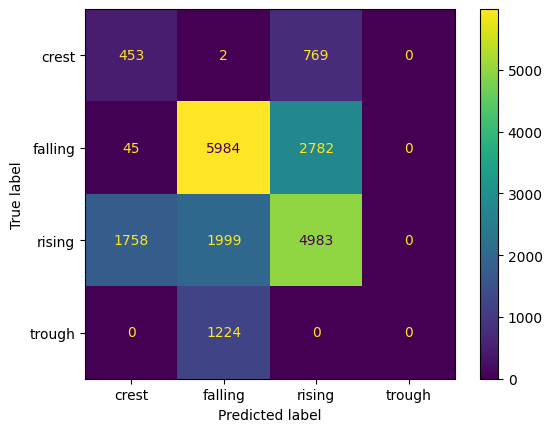

c:\Users\manch\OneDrive\Documents\DEV\MachineLearning\hands_On_Machine_Learning\lib\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



ADA Classification Report:
              precision    recall  f1-score   support

       crest       0.20      0.37      0.26      1224
     falling       0.65      0.68      0.66      8811
      rising       0.58      0.57      0.58      8740
      trough       0.00      0.00      0.00      1224

    accuracy                           0.57     19999
   macro avg       0.36      0.40      0.38     19999
weighted avg       0.55      0.57      0.56     19999



c:\Users\manch\OneDrive\Documents\DEV\MachineLearning\hands_On_Machine_Learning\lib\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

c:\Users\manch\OneDrive\Documents\DEV\MachineLearning\hands_On_Machine_Learning\lib\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



In [23]:
y_pred=clf.predict(X_test)
ConfusionMatrixDisplay.from_predictions(y_test, y_pred)
plt.show()
print(f"ADA Classification Report:\n{classification_report(y_test, y_pred)}")

In [24]:
ADA_clf =   AdaBoostClassifier(RandomForestClassifier(max_depth=1), n_estimators=30,learning_rate=0.5, random_state=42)
clf=ADA_clf
clf.fit(X=X_train,y=y_train)

c:\Users\manch\OneDrive\Documents\DEV\MachineLearning\hands_On_Machine_Learning\lib\site-packages\sklearn\ensemble\_weight_boosting.py:527: FutureWarning:

The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.



AdaBoostClassifier(estimator=RandomForestClassifier(max_depth=1),
                   learning_rate=0.5, n_estimators=30, random_state=42)

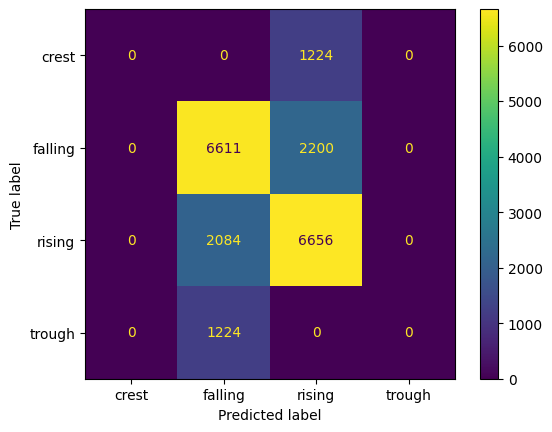

c:\Users\manch\OneDrive\Documents\DEV\MachineLearning\hands_On_Machine_Learning\lib\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



ADA Classification Report:
              precision    recall  f1-score   support

       crest       0.00      0.00      0.00      1224
     falling       0.67      0.75      0.71      8811
      rising       0.66      0.76      0.71      8740
      trough       0.00      0.00      0.00      1224

    accuracy                           0.66     19999
   macro avg       0.33      0.38      0.35     19999
weighted avg       0.58      0.66      0.62     19999



c:\Users\manch\OneDrive\Documents\DEV\MachineLearning\hands_On_Machine_Learning\lib\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

c:\Users\manch\OneDrive\Documents\DEV\MachineLearning\hands_On_Machine_Learning\lib\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



In [25]:
y_pred=clf.predict(X_test)
ConfusionMatrixDisplay.from_predictions(y_test, y_pred)
plt.show()
print(f"ADA Classification Report:\n{classification_report(y_test, y_pred)}")

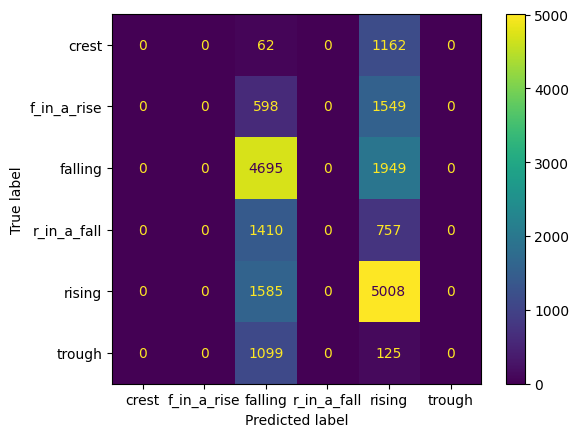

c:\Users\manch\OneDrive\Documents\DEV\MachineLearning\hands_On_Machine_Learning\lib\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\manch\OneDrive\Documents\DEV\MachineLearning\hands_On_Machine_Learning\lib\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\manch\OneDrive\Documents\DEV\MachineLearning\hands_On_Machine_Learning\lib\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use 

ADA Classification Report:
              precision    recall  f1-score   support

       crest       0.00      0.00      0.00      1224
 f_in_a_rise       0.00      0.00      0.00      2147
     falling       0.50      0.71      0.58      6644
 r_in_a_fall       0.00      0.00      0.00      2167
      rising       0.47      0.76      0.58      6593
      trough       0.00      0.00      0.00      1224

    accuracy                           0.49     19999
   macro avg       0.16      0.24      0.19     19999
weighted avg       0.32      0.49      0.39     19999



c:\Users\manch\OneDrive\Documents\DEV\MachineLearning\hands_On_Machine_Learning\lib\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\manch\OneDrive\Documents\DEV\MachineLearning\hands_On_Machine_Learning\lib\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\manch\OneDrive\Documents\DEV\MachineLearning\hands_On_Machine_Learning\lib\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use 

{'crest': {'precision': 0.0,
  'recall': 0.0,
  'f1-score': 0.0,
  'support': 1224.0},
 'f_in_a_rise': {'precision': 0.0,
  'recall': 0.0,
  'f1-score': 0.0,
  'support': 2147.0},
 'falling': {'precision': 0.4968779765054503,
  'recall': 0.7066526189042746,
  'f1-score': 0.5834835021437892,
  'support': 6644.0},
 'r_in_a_fall': {'precision': 0.0,
  'recall': 0.0,
  'f1-score': 0.0,
  'support': 2167.0},
 'rising': {'precision': 0.4746919431279621,
  'recall': 0.7595935082663431,
  'f1-score': 0.5842617978183515,
  'support': 6593.0},
 'trough': {'precision': 0.0,
  'recall': 0.0,
  'f1-score': 0.0,
  'support': 1224.0},
 'accuracy': 0.4851742587129356,
 'macro avg': {'precision': 0.16192831993890208,
  'recall': 0.24437435452843626,
  'f1-score': 0.19462421666035679,
  'support': 19999.0},
 'weighted avg': {'precision': 0.3215611409042885,
  'recall': 0.4851742587129356,
  'f1-score': 0.3864544437851756,
  'support': 19999.0}}

In [5]:
crest_clf=QuadraticDiscriminantAnalysis()
clf=PassiveAggressiveClassifier(C=1,early_stopping=True,validation_fraction=0.2,fit_intercept=True,max_iter=10000,random_state=10)
def train_and_Evaluate(model,x1,y1,x2,y2):
    model.fit(x1,y1)
    y_pred=model.predict(x2)
    ConfusionMatrixDisplay.from_predictions(y2, y_pred)
    plt.show()
    print(f"ADA Classification Report:\n{classification_report(y_test, y_pred)}")
    return classification_report(y_test, y_pred,output_dict=True)

train_and_Evaluate(model=clf,x1=X_train,y1=y_train,x2=X_test,y2=y_test)

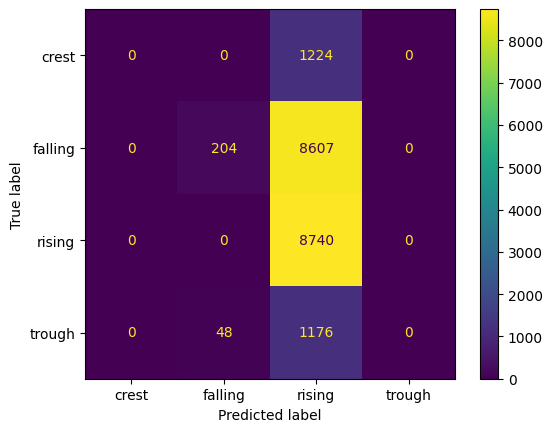

c:\Users\manch\OneDrive\Documents\DEV\MachineLearning\hands_On_Machine_Learning\lib\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

c:\Users\manch\OneDrive\Documents\DEV\MachineLearning\hands_On_Machine_Learning\lib\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

c:\Users\manch\OneDrive\Documents\DEV\MachineLearning\hands_On_Machine_Learning\lib\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



ADA Classification Report:
              precision    recall  f1-score   support

       crest       0.00      0.00      0.00      1224
     falling       0.81      0.02      0.05      8811
      rising       0.44      1.00      0.61      8740
      trough       0.00      0.00      0.00      1224

    accuracy                           0.45     19999
   macro avg       0.31      0.26      0.16     19999
weighted avg       0.55      0.45      0.29     19999



c:\Users\manch\OneDrive\Documents\DEV\MachineLearning\hands_On_Machine_Learning\lib\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

c:\Users\manch\OneDrive\Documents\DEV\MachineLearning\hands_On_Machine_Learning\lib\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

c:\Users\manch\OneDrive\Documents\DEV\MachineLearning\hands_On_Machine_Learning\lib\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



In [27]:
clf=PassiveAggressiveClassifier(random_state=4)
eval_df=train_and_Evaluate(model=clf,x1=X_train,y1=y_train,x2=X_test,y2=y_test)

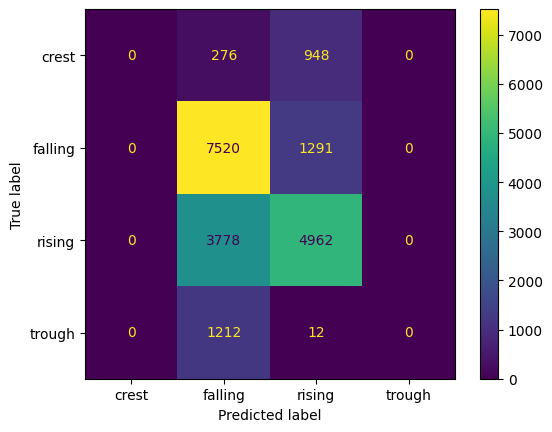

c:\Users\manch\OneDrive\Documents\DEV\MachineLearning\hands_On_Machine_Learning\lib\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

c:\Users\manch\OneDrive\Documents\DEV\MachineLearning\hands_On_Machine_Learning\lib\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

c:\Users\manch\OneDrive\Documents\DEV\MachineLearning\hands_On_Machine_Learning\lib\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

c:\Users\manch\OneDrive\Documents\DEV\MachineLearning\hands_On_Machine_Learning\lib\site

ADA Classification Report:
              precision    recall  f1-score   support

       crest       0.00      0.00      0.00      1224
     falling       0.59      0.85      0.70      8811
      rising       0.69      0.57      0.62      8740
      trough       0.00      0.00      0.00      1224

    accuracy                           0.62     19999
   macro avg       0.32      0.36      0.33     19999
weighted avg       0.56      0.62      0.58     19999



c:\Users\manch\OneDrive\Documents\DEV\MachineLearning\hands_On_Machine_Learning\lib\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

c:\Users\manch\OneDrive\Documents\DEV\MachineLearning\hands_On_Machine_Learning\lib\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



In [28]:
clf=PassiveAggressiveClassifier(random_state=19)
eval_df=train_and_Evaluate(model=clf,x1=X_train,y1=y_train,x2=X_test,y2=y_test)

In [29]:
eval_df["crest"]['recall']

0.0

In [30]:
"""for i in range(0,1000):
    clf=PassiveAggressiveClassifier(random_state=i)
    eval_df=train_and_Evaluate(model=clf,x1=X_train,y1=y_train,x2=X_test,y2=y_test)
    if eval_df["ri"]['recall']>0.9:
        break
    print(i)"""


'for i in range(0,1000):\n    clf=PassiveAggressiveClassifier(random_state=i)\n    eval_df=train_and_Evaluate(model=clf,x1=X_train,y1=y_train,x2=X_test,y2=y_test)\n    if eval_df["ri"][\'recall\']>0.9:\n        break\n    print(i)'

In [31]:
y_train_rising=(y_train=='rising')
y_test_rising=(y_test=='rising')

In [32]:
voting_clf_1 = VotingClassifier(
 estimators=[
 ('bag_clf',BaggingClassifier(DecisionTreeClassifier(), n_estimators=50,oob_score=True, n_jobs=-1, random_state=42)),
 ('sgd_clf',SGDClassifier(loss='hinge',penalty='l1')),
 ('knn_clf',KNeighborsClassifier(n_neighbors=1,n_jobs=-1)),
 ('pag_clf',PassiveAggressiveClassifier(random_state=67)),
 ('GNB_clf',GaussianNB())
 ]
)
voting_clf_2 = VotingClassifier(
 estimators=[
 ('logreg',   LogisticRegression(random_state=42)),
 ('gbc_clf',  GradientBoostingClassifier(max_depth=2, n_estimators=100,learning_rate=0.05, random_state=42)),
 ('ada_clf',  AdaBoostClassifier(RandomForestClassifier(max_depth=2),n_estimators=30,learning_rate=0.5, random_state=42)),
 ('hist_clf', HistGradientBoostingClassifier(max_depth=6,learning_rate=0.02, random_state=7))
 ]
)
voting_clf_3 = VotingClassifier(
 estimators=[
 ('bag_clf',BaggingClassifier(DecisionTreeClassifier(), n_estimators=50,oob_score=True, n_jobs=-1, random_state=42)),
 ('gbc_clf',  GradientBoostingClassifier(max_depth=2, n_estimators=100,learning_rate=0.05, random_state=42)),
 ('sgd_clf',SGDClassifier(loss='hinge',penalty='l1')),
 ('ada_clf',  AdaBoostClassifier(ExtraTreesClassifier(max_depth=5),n_estimators=30,learning_rate=0.5, random_state=42)),
 ('knn_clf',KNeighborsClassifier(n_neighbors=1,n_jobs=-1)),
 ('hist_clf', HistGradientBoostingClassifier(max_depth=6,learning_rate=0.02, random_state=9))
 ]
)
metrics=['p', 'precomputed', 'cityblock', 'chebyshev', 'pyfunc', 'infinity', 'euclidean', 'mahalanobis', 'l1', 'correlation', 'russellrao', 'sokalsneath', 'minkowski', 'braycurtis', 'rogerstanimoto', 'sokalmichener', 'l2', 'cosine', 'hamming', 'dice', 'seuclidean', 'haversine', 'manhattan', 'nan_euclidean', 'sqeuclidean', 'jaccard', 'canberra', 'yule']
knn_clf =   KNeighborsClassifier(n_neighbors=20,algorithm='kd_tree',weights='distance',leaf_size=100,metric=metrics[6],n_jobs=-1)
bag_clf =   BaggingClassifier(DecisionTreeClassifier(), n_estimators=500,max_samples=100, n_jobs=-1, random_state=42)
sgd_clf =   SGDClassifier(loss='hinge',penalty='l1')
rfstclf =   RandomForestClassifier(n_estimators=500, max_leaf_nodes=16,n_jobs=-1, random_state=42)
EXT_clf =   ExtraTreesClassifier()
LogRclf =   LogisticRegression()
DecTclf =   DecisionTreeClassifier()
GDB_clf =   GradientBoostingClassifier(max_depth=5, n_estimators=500,learning_rate=0.025, random_state=2)
QDA_clf =   QuadraticDiscriminantAnalysis()
ADA_clf =   AdaBoostClassifier(DecisionTreeClassifier(max_depth=1), n_estimators=30,learning_rate=0.5, random_state=42)
GNB_clf =   GaussianNB()
BNB_clf =   BernoulliNB()
LDA_clf =   LinearDiscriminantAnalysis()
PRP_clf =   Perceptron()
PAG_clf =   PassiveAggressiveClassifier()

classifiers={'voting_1':voting_clf_1,
             'voting_2':voting_clf_2,
             'voting_3':voting_clf_3,
             'KNN Classifier':knn_clf,
             'Bagging Classifier':bag_clf,
             'StochasticGD Classifier':sgd_clf,
             'RandomFST Classifier':rfstclf,
            'ExtraTreesClassifier':EXT_clf,
            'LogisticRegression Classifier':LogRclf,
            'DecisionTree   Classifier':DecTclf,
            'GradientBoosting Classifier':GDB_clf,
            'QuadraticDA Classifier':QDA_clf,
            'AdaBoost   Classifier':ADA_clf,
            'GaussianNB Classifier':GNB_clf,
            'BernoulliNB Classifier':BNB_clf,
            'LinearDA Classifier':LDA_clf,
            'Perceptron Classifier':PRP_clf,
            'PassiveAG Classifier':PAG_clf,
             }
from sklearn.metrics import classification_report, accuracy_score
import pandas as pd

def train_and_evaluate(classifiers, action='train', X_train=None, y_train=None, X_test=None, y_test=None):
    results = []
    
    for name, clf in classifiers.items():
        if action == 'train':
            print(f"Training {name}...")
            clf.fit(X_train, y_train)
        elif action == 'evaluate':
            print(f"Evaluating {name}...")
            y_pred = clf.predict(X_test)
            report = classification_report(y_test, y_pred, output_dict=True)
            accuracy = accuracy_score(y_test, y_pred)
            # Collecting metrics in a dictionary
            metrics = {'Model': name}
            for label, metrics_dict in report.items():
                if label not in ['accuracy', 'macro avg', 'weighted avg']:
                    metrics[f'{label} Precision'] = metrics_dict['precision']
                    metrics[f'{label} Recall'] = metrics_dict['recall']
                    metrics[f'{label} F1 Score'] = metrics_dict['f1-score']
            metrics['Accuracy'] = accuracy
            results.append(metrics)
        else:
            raise ValueError("Action must be either 'train' or 'evaluate'")
    
    if action == 'evaluate':
        df = pd.DataFrame(results)
        return df


In [33]:
train_and_evaluate(classifiers, action='train', X_train=X_train, y_train=y_train_rising)

Training voting_1...
Training voting_2...


c:\Users\manch\OneDrive\Documents\DEV\MachineLearning\hands_On_Machine_Learning\lib\site-packages\sklearn\linear_model\_logistic.py:469: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

c:\Users\manch\OneDrive\Documents\DEV\MachineLearning\hands_On_Machine_Learning\lib\site-packages\sklearn\ensemble\_weight_boosting.py:527: FutureWarning:

The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.



Training voting_3...


c:\Users\manch\OneDrive\Documents\DEV\MachineLearning\hands_On_Machine_Learning\lib\site-packages\sklearn\ensemble\_weight_boosting.py:527: FutureWarning:

The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.



Training KNN Classifier...
Training Bagging Classifier...
Training StochasticGD Classifier...
Training RandomFST Classifier...
Training ExtraTreesClassifier...
Training LogisticRegression Classifier...


c:\Users\manch\OneDrive\Documents\DEV\MachineLearning\hands_On_Machine_Learning\lib\site-packages\sklearn\linear_model\_logistic.py:469: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



Training DecisionTree   Classifier...
Training GradientBoosting Classifier...
Training QuadraticDA Classifier...
Training AdaBoost   Classifier...


c:\Users\manch\OneDrive\Documents\DEV\MachineLearning\hands_On_Machine_Learning\lib\site-packages\sklearn\discriminant_analysis.py:949: UserWarning:

Variables are collinear

c:\Users\manch\OneDrive\Documents\DEV\MachineLearning\hands_On_Machine_Learning\lib\site-packages\sklearn\ensemble\_weight_boosting.py:527: FutureWarning:

The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.



Training GaussianNB Classifier...
Training BernoulliNB Classifier...
Training LinearDA Classifier...
Training Perceptron Classifier...
Training PassiveAG Classifier...


In [34]:
# To evaluate the classifiers and get the DataFrame
evaluation_df = train_and_evaluate(classifiers, action='evaluate', X_test=X_test, y_test=y_test_rising)

Evaluating voting_1...
Evaluating voting_2...
Evaluating voting_3...
Evaluating KNN Classifier...
Evaluating Bagging Classifier...
Evaluating StochasticGD Classifier...
Evaluating RandomFST Classifier...
Evaluating ExtraTreesClassifier...
Evaluating LogisticRegression Classifier...
Evaluating DecisionTree   Classifier...
Evaluating GradientBoosting Classifier...
Evaluating QuadraticDA Classifier...
Evaluating AdaBoost   Classifier...
Evaluating GaussianNB Classifier...
Evaluating BernoulliNB Classifier...
Evaluating LinearDA Classifier...
Evaluating Perceptron Classifier...
Evaluating PassiveAG Classifier...


In [35]:

px.bar(data_frame=evaluation_df,x='Model',y='Accuracy',color='Accuracy',title='Models Accuracy')

In [36]:
px.scatter_3d(data_frame=evaluation_df,x='False Precision', y='False Recall', z='False F1 Score',color='Model')

In [37]:
px.scatter_3d(data_frame=evaluation_df,x='True Precision', y='True Recall', z='True F1 Score',color='Model')

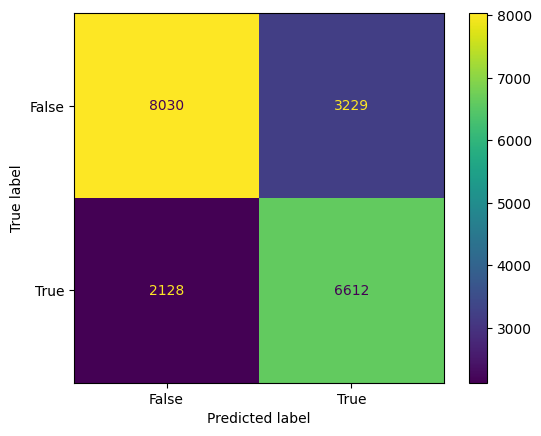

RandomFST Classifier report
               precision    recall  f1-score   support

       False       0.79      0.71      0.75     11259
        True       0.67      0.76      0.71      8740

    accuracy                           0.73     19999
   macro avg       0.73      0.73      0.73     19999
weighted avg       0.74      0.73      0.73     19999



In [38]:
model_names=evaluation_df['Model']
model_name=model_names[6]
y_pred=classifiers[model_name].predict(X_test)
ConfusionMatrixDisplay.from_predictions(y_test_rising, y_pred)
plt.show()
print(f"{model_name} report\n",classification_report(y_pred=y_pred,y_true=y_test_rising))

In [39]:
y_pred

array([False, False, False, ..., False, False, False])

In [40]:
target_class = True
false_positives = X_test[(y_test_rising != target_class) & (y_pred == target_class)]
false_positive_labels = y_test[(y_test_rising != target_class) & (y_pred == target_class)]
print(len(false_positives))

3229


In [41]:
import pandas as pd

# Example DataFrame
data = {
    'A': [1, 2, 3, 4, 5],
    'B': ['x', 'y', 'x', 'y', 'x']
}

df = pd.DataFrame(data)

# Edit values in column A where the condition in column B is met
# For example, set values in column A to 10 where column B is 'x'
df.loc[(df['B'] == 'x') & (df['A'] == 1), 'A'] = 10

print(df)


    A  B
0  10  x
1   2  y
2   3  x
3   4  y
4   5  x


In [42]:
dfMain=data_frame(pair_name="dfUltimate_Moving Average Trends_STEP_2024_M1_9_3_14_20_28_99999.csv")
dfMain.keys()
df=pd.DataFrame(data=dfMain)
df.loc[(df['Slope Close'] >0.000000001)     &   (df['Peak']=='falling'), 'Peak'] = 'r_in_a_fall'
df.loc[(df['Slope Close'] <-0.000000001 )   &    (df['Peak']=='rising'), 'Peak'] = 'f_in_a_rise'
y=dfMain["Peak"]
X=dfMain.copy()
X.pop('Trend Change')
X.pop('Slope Trend')
X.pop('Time Stamps')
X.pop('Instance')
X.pop("Peak")
scaler = StandardScaler()
X_svc =scaler.fit_transform(X.astype("float64"))
X_train, X_test, y_train, y_test = X[:80000], X[80000:], y[:80000], y[80000:]

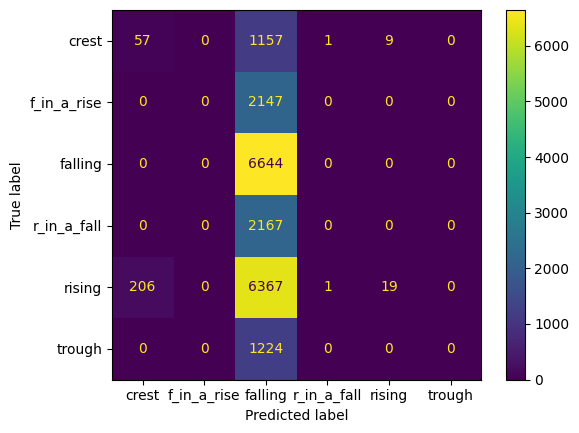

c:\Users\manch\OneDrive\Documents\DEV\MachineLearning\hands_On_Machine_Learning\lib\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

c:\Users\manch\OneDrive\Documents\DEV\MachineLearning\hands_On_Machine_Learning\lib\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

c:\Users\manch\OneDrive\Documents\DEV\MachineLearning\hands_On_Machine_Learning\lib\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

c:\Users\manch\OneDrive\Documents\DEV\MachineLearning\hands_On_Machine_Learning\lib\site

ADA Classification Report:
              precision    recall  f1-score   support

       crest       0.22      0.05      0.08      1224
 f_in_a_rise       0.00      0.00      0.00      2147
     falling       0.34      1.00      0.50      6644
 r_in_a_fall       0.00      0.00      0.00      2167
      rising       0.68      0.00      0.01      6593
      trough       0.00      0.00      0.00      1224

    accuracy                           0.34     19999
   macro avg       0.21      0.17      0.10     19999
weighted avg       0.35      0.34      0.17     19999



c:\Users\manch\OneDrive\Documents\DEV\MachineLearning\hands_On_Machine_Learning\lib\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

c:\Users\manch\OneDrive\Documents\DEV\MachineLearning\hands_On_Machine_Learning\lib\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



{'crest': {'precision': 0.21673003802281368,
  'recall': 0.04656862745098039,
  'f1-score': 0.07666442501681238,
  'support': 1224.0},
 'f_in_a_rise': {'precision': 0.0,
  'recall': 0.0,
  'f1-score': 0.0,
  'support': 2147.0},
 'falling': {'precision': 0.33715619608241143,
  'recall': 1.0,
  'f1-score': 0.5042884250474383,
  'support': 6644.0},
 'r_in_a_fall': {'precision': 0.0,
  'recall': 0.0,
  'f1-score': 0.0,
  'support': 2167.0},
 'rising': {'precision': 0.6785714285714286,
  'recall': 0.002881844380403458,
  'f1-score': 0.0057393143029753815,
  'support': 6593.0},
 'trough': {'precision': 0.0,
  'recall': 0.0,
  'f1-score': 0.0,
  'support': 1224.0},
 'accuracy': 0.336016800840042,
 'macro avg': {'precision': 0.20540961044610895,
  'recall': 0.17490841197189733,
  'f1-score': 0.09778202739453767,
  'support': 19999.0},
 'weighted avg': {'precision': 0.3489756868784886,
  'recall': 0.336016800840042,
  'f1-score': 0.17411714842918521,
  'support': 19999.0}}

In [43]:
model=Perceptron(penalty='elasticnet',alpha=0.00069,random_state=8)
model1=SGDClassifier(loss='perceptron',penalty='l2')
model2=PassiveAggressiveClassifier(random_state=19)
model3=AdaBoostClassifier(RandomForestClassifier(max_depth=1), n_estimators=30,learning_rate=0.05, random_state=42)
model4=AdaBoostClassifier(DecisionTreeClassifier(max_depth=5), n_estimators=50,learning_rate=0.001, random_state=37)
model5=AdaBoostClassifier(ExtraTreesClassifier(max_depth=5), n_estimators=30,learning_rate=0.05, random_state=42)
train_and_Evaluate(model=model1,x1=X_train,y1=y_train,x2=X_test,y2=y_test)

In [44]:
px.scatter_3d(data_frame=dfMain,x='POIChange',y='Slope Close',z='Slope Ma',color='Peak')

In [45]:
train_and_evaluate(classifiers, action='train', X_train=X_train, y_train=y_train)

Training voting_1...
Training voting_2...


c:\Users\manch\OneDrive\Documents\DEV\MachineLearning\hands_On_Machine_Learning\lib\site-packages\sklearn\linear_model\_logistic.py:469: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

c:\Users\manch\OneDrive\Documents\DEV\MachineLearning\hands_On_Machine_Learning\lib\site-packages\sklearn\ensemble\_weight_boosting.py:527: FutureWarning:

The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.



Training voting_3...


c:\Users\manch\OneDrive\Documents\DEV\MachineLearning\hands_On_Machine_Learning\lib\site-packages\sklearn\ensemble\_weight_boosting.py:527: FutureWarning:

The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.



Training KNN Classifier...
Training Bagging Classifier...
Training StochasticGD Classifier...
Training RandomFST Classifier...
Training ExtraTreesClassifier...
Training LogisticRegression Classifier...


c:\Users\manch\OneDrive\Documents\DEV\MachineLearning\hands_On_Machine_Learning\lib\site-packages\sklearn\linear_model\_logistic.py:469: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



Training DecisionTree   Classifier...
Training GradientBoosting Classifier...
Training QuadraticDA Classifier...


c:\Users\manch\OneDrive\Documents\DEV\MachineLearning\hands_On_Machine_Learning\lib\site-packages\sklearn\discriminant_analysis.py:949: UserWarning:

Variables are collinear

c:\Users\manch\OneDrive\Documents\DEV\MachineLearning\hands_On_Machine_Learning\lib\site-packages\sklearn\ensemble\_weight_boosting.py:527: FutureWarning:

The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.



Training AdaBoost   Classifier...
Training GaussianNB Classifier...
Training BernoulliNB Classifier...
Training LinearDA Classifier...
Training Perceptron Classifier...
Training PassiveAG Classifier...


In [46]:
evaluation_df = train_and_evaluate(classifiers, action='evaluate', X_test=X_test, y_test=y_test)

Evaluating voting_1...
Evaluating voting_2...
Evaluating voting_3...
Evaluating KNN Classifier...
Evaluating Bagging Classifier...
Evaluating StochasticGD Classifier...


c:\Users\manch\OneDrive\Documents\DEV\MachineLearning\hands_On_Machine_Learning\lib\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

c:\Users\manch\OneDrive\Documents\DEV\MachineLearning\hands_On_Machine_Learning\lib\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

c:\Users\manch\OneDrive\Documents\DEV\MachineLearning\hands_On_Machine_Learning\lib\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



Evaluating RandomFST Classifier...


c:\Users\manch\OneDrive\Documents\DEV\MachineLearning\hands_On_Machine_Learning\lib\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

c:\Users\manch\OneDrive\Documents\DEV\MachineLearning\hands_On_Machine_Learning\lib\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

c:\Users\manch\OneDrive\Documents\DEV\MachineLearning\hands_On_Machine_Learning\lib\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



Evaluating ExtraTreesClassifier...
Evaluating LogisticRegression Classifier...


c:\Users\manch\OneDrive\Documents\DEV\MachineLearning\hands_On_Machine_Learning\lib\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

c:\Users\manch\OneDrive\Documents\DEV\MachineLearning\hands_On_Machine_Learning\lib\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

c:\Users\manch\OneDrive\Documents\DEV\MachineLearning\hands_On_Machine_Learning\lib\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



Evaluating DecisionTree   Classifier...
Evaluating GradientBoosting Classifier...
Evaluating QuadraticDA Classifier...
Evaluating AdaBoost   Classifier...


c:\Users\manch\OneDrive\Documents\DEV\MachineLearning\hands_On_Machine_Learning\lib\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

c:\Users\manch\OneDrive\Documents\DEV\MachineLearning\hands_On_Machine_Learning\lib\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

c:\Users\manch\OneDrive\Documents\DEV\MachineLearning\hands_On_Machine_Learning\lib\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



Evaluating GaussianNB Classifier...
Evaluating BernoulliNB Classifier...
Evaluating LinearDA Classifier...
Evaluating Perceptron Classifier...


c:\Users\manch\OneDrive\Documents\DEV\MachineLearning\hands_On_Machine_Learning\lib\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

c:\Users\manch\OneDrive\Documents\DEV\MachineLearning\hands_On_Machine_Learning\lib\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

c:\Users\manch\OneDrive\Documents\DEV\MachineLearning\hands_On_Machine_Learning\lib\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



Evaluating PassiveAG Classifier...


c:\Users\manch\OneDrive\Documents\DEV\MachineLearning\hands_On_Machine_Learning\lib\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

c:\Users\manch\OneDrive\Documents\DEV\MachineLearning\hands_On_Machine_Learning\lib\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

c:\Users\manch\OneDrive\Documents\DEV\MachineLearning\hands_On_Machine_Learning\lib\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



In [47]:
px.bar(data_frame=evaluation_df,x='Model',y='Accuracy',color='Accuracy',title='Models Accuracy')

In [49]:
px.scatter_3d(data_frame=evaluation_df,x='crest Precision', y='crest Recall', z='crest F1 Score',color='Model')

In [50]:
px.scatter_3d(data_frame=evaluation_df,x='trough Precision', y='trough Recall', z='trough F1 Score',color='Model')

In [51]:
px.scatter_3d(data_frame=evaluation_df,x='falling Precision', y='falling Recall', z='falling F1 Score',color='Model')

In [52]:
px.scatter_3d(data_frame=evaluation_df,x='rising Precision', y='rising Recall', z='rising F1 Score',color='Model')

In [55]:
px.scatter_3d(data_frame=evaluation_df,x='r_in_a_fall Precision', y='r_in_a_fall Recall', z='r_in_a_fall F1 Score',color='Model')

In [57]:
px.scatter_3d(data_frame=evaluation_df,x='f_in_a_rise Precision', y='f_in_a_rise Recall', z='f_in_a_rise F1 Score',color='Model')

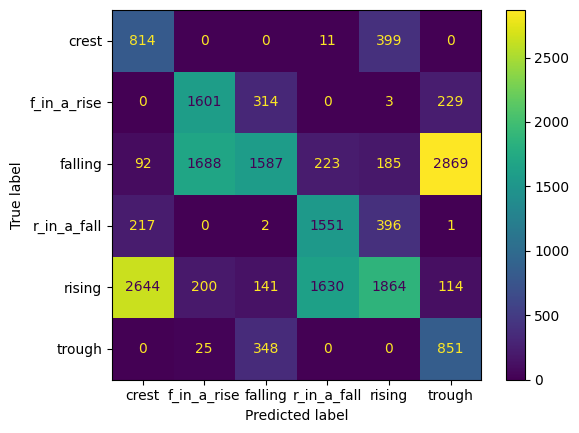

GaussianNB Classifier report
               precision    recall  f1-score   support

       crest       0.22      0.67      0.33      1224
 f_in_a_rise       0.46      0.75      0.57      2147
     falling       0.66      0.24      0.35      6644
 r_in_a_fall       0.45      0.72      0.56      2167
      rising       0.65      0.28      0.39      6593
      trough       0.21      0.70      0.32      1224

    accuracy                           0.41     19999
   macro avg       0.44      0.56      0.42     19999
weighted avg       0.56      0.41      0.41     19999



In [60]:
model_names=evaluation_df['Model']
model_name=model_names[13]
y_pred=classifiers[model_name].predict(X_test)
ConfusionMatrixDisplay.from_predictions(y_test, y_pred)
plt.show()
print(f"{model_name} report\n",classification_report(y_pred=y_pred,y_true=y_test))

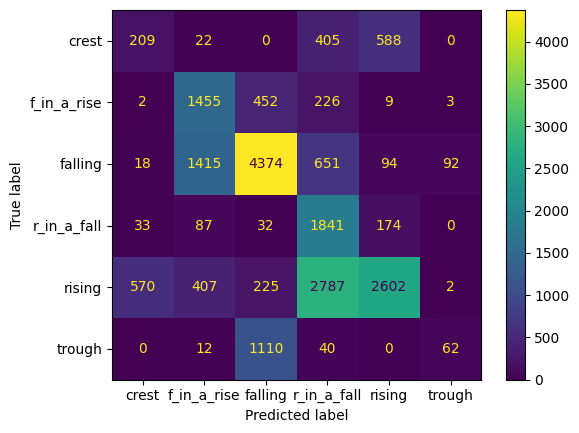

voting_1 report
               precision    recall  f1-score   support

       crest       0.25      0.17      0.20      1224
 f_in_a_rise       0.43      0.68      0.52      2147
     falling       0.71      0.66      0.68      6644
 r_in_a_fall       0.31      0.85      0.45      2167
      rising       0.75      0.39      0.52      6593
      trough       0.39      0.05      0.09      1224

    accuracy                           0.53     19999
   macro avg       0.47      0.47      0.41     19999
weighted avg       0.60      0.53      0.52     19999



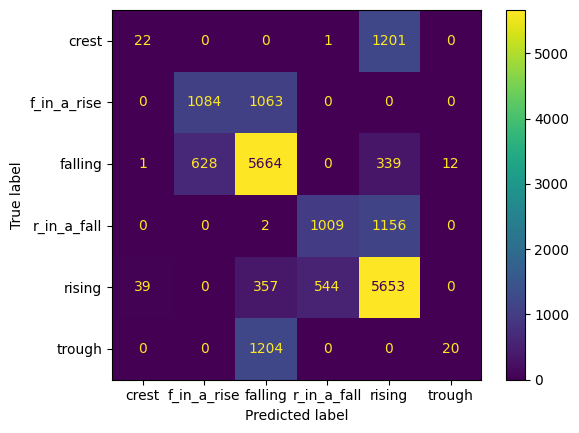

voting_2 report
               precision    recall  f1-score   support

       crest       0.35      0.02      0.03      1224
 f_in_a_rise       0.63      0.50      0.56      2147
     falling       0.68      0.85      0.76      6644
 r_in_a_fall       0.65      0.47      0.54      2167
      rising       0.68      0.86      0.76      6593
      trough       0.62      0.02      0.03      1224

    accuracy                           0.67     19999
   macro avg       0.60      0.45      0.45     19999
weighted avg       0.65      0.67      0.62     19999



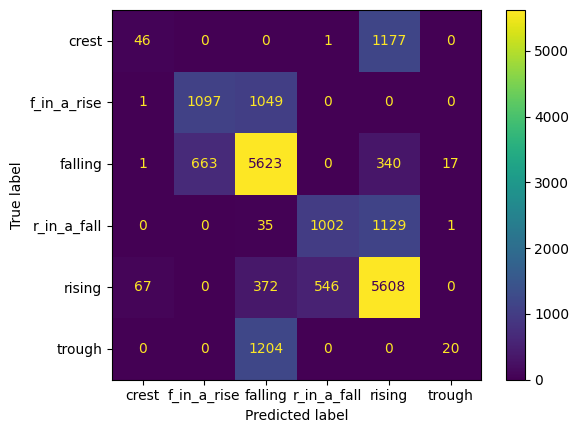

voting_3 report
               precision    recall  f1-score   support

       crest       0.40      0.04      0.07      1224
 f_in_a_rise       0.62      0.51      0.56      2147
     falling       0.68      0.85      0.75      6644
 r_in_a_fall       0.65      0.46      0.54      2167
      rising       0.68      0.85      0.76      6593
      trough       0.53      0.02      0.03      1224

    accuracy                           0.67     19999
   macro avg       0.59      0.45      0.45     19999
weighted avg       0.64      0.67      0.62     19999



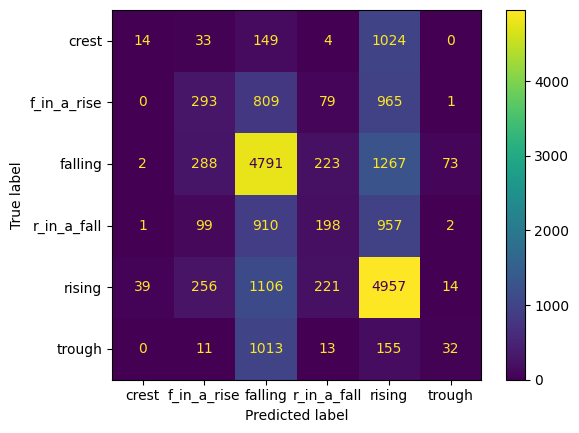

KNN Classifier report
               precision    recall  f1-score   support

       crest       0.25      0.01      0.02      1224
 f_in_a_rise       0.30      0.14      0.19      2147
     falling       0.55      0.72      0.62      6644
 r_in_a_fall       0.27      0.09      0.14      2167
      rising       0.53      0.75      0.62      6593
      trough       0.26      0.03      0.05      1224

    accuracy                           0.51     19999
   macro avg       0.36      0.29      0.27     19999
weighted avg       0.45      0.51      0.45     19999



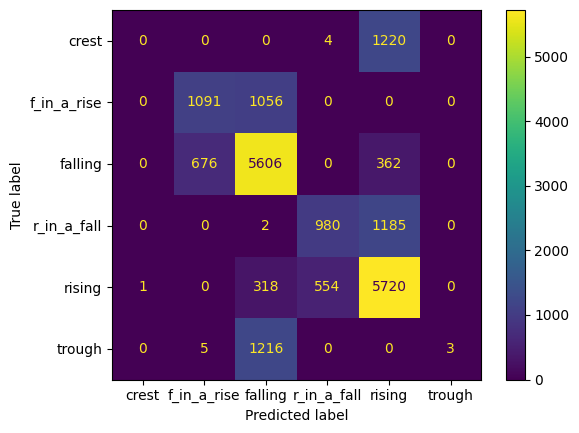

Bagging Classifier report
               precision    recall  f1-score   support

       crest       0.00      0.00      0.00      1224
 f_in_a_rise       0.62      0.51      0.56      2147
     falling       0.68      0.84      0.76      6644
 r_in_a_fall       0.64      0.45      0.53      2167
      rising       0.67      0.87      0.76      6593
      trough       1.00      0.00      0.00      1224

    accuracy                           0.67     19999
   macro avg       0.60      0.45      0.43     19999
weighted avg       0.65      0.67      0.62     19999



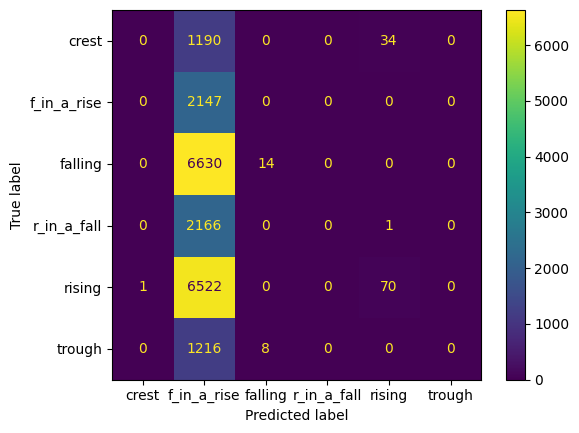

c:\Users\manch\OneDrive\Documents\DEV\MachineLearning\hands_On_Machine_Learning\lib\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

c:\Users\manch\OneDrive\Documents\DEV\MachineLearning\hands_On_Machine_Learning\lib\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

c:\Users\manch\OneDrive\Documents\DEV\MachineLearning\hands_On_Machine_Learning\lib\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



StochasticGD Classifier report
               precision    recall  f1-score   support

       crest       0.00      0.00      0.00      1224
 f_in_a_rise       0.11      1.00      0.20      2147
     falling       0.64      0.00      0.00      6644
 r_in_a_fall       0.00      0.00      0.00      2167
      rising       0.67      0.01      0.02      6593
      trough       0.00      0.00      0.00      1224

    accuracy                           0.11     19999
   macro avg       0.24      0.17      0.04     19999
weighted avg       0.44      0.11      0.03     19999



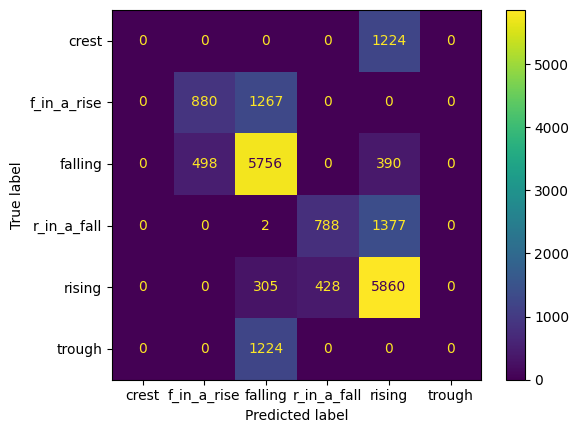

c:\Users\manch\OneDrive\Documents\DEV\MachineLearning\hands_On_Machine_Learning\lib\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

c:\Users\manch\OneDrive\Documents\DEV\MachineLearning\hands_On_Machine_Learning\lib\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

c:\Users\manch\OneDrive\Documents\DEV\MachineLearning\hands_On_Machine_Learning\lib\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



RandomFST Classifier report
               precision    recall  f1-score   support

       crest       0.00      0.00      0.00      1224
 f_in_a_rise       0.64      0.41      0.50      2147
     falling       0.67      0.87      0.76      6644
 r_in_a_fall       0.65      0.36      0.47      2167
      rising       0.66      0.89      0.76      6593
      trough       0.00      0.00      0.00      1224

    accuracy                           0.66     19999
   macro avg       0.44      0.42      0.41     19999
weighted avg       0.58      0.66      0.61     19999



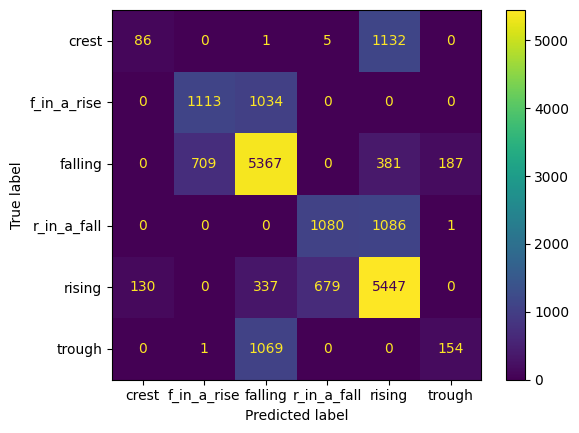

ExtraTreesClassifier report
               precision    recall  f1-score   support

       crest       0.40      0.07      0.12      1224
 f_in_a_rise       0.61      0.52      0.56      2147
     falling       0.69      0.81      0.74      6644
 r_in_a_fall       0.61      0.50      0.55      2167
      rising       0.68      0.83      0.74      6593
      trough       0.45      0.13      0.20      1224

    accuracy                           0.66     19999
   macro avg       0.57      0.47      0.49     19999
weighted avg       0.64      0.66      0.63     19999



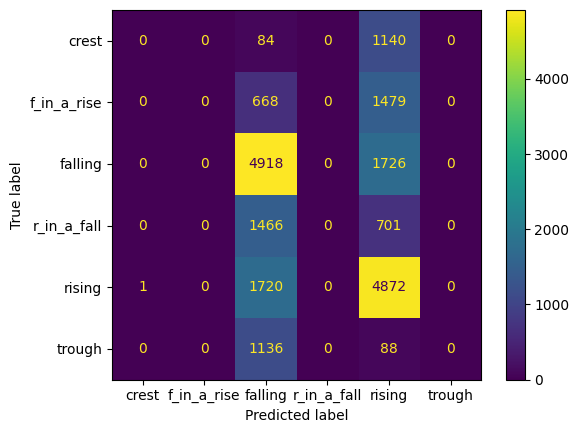

c:\Users\manch\OneDrive\Documents\DEV\MachineLearning\hands_On_Machine_Learning\lib\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

c:\Users\manch\OneDrive\Documents\DEV\MachineLearning\hands_On_Machine_Learning\lib\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

c:\Users\manch\OneDrive\Documents\DEV\MachineLearning\hands_On_Machine_Learning\lib\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



LogisticRegression Classifier report
               precision    recall  f1-score   support

       crest       0.00      0.00      0.00      1224
 f_in_a_rise       0.00      0.00      0.00      2147
     falling       0.49      0.74      0.59      6644
 r_in_a_fall       0.00      0.00      0.00      2167
      rising       0.49      0.74      0.59      6593
      trough       0.00      0.00      0.00      1224

    accuracy                           0.49     19999
   macro avg       0.16      0.25      0.20     19999
weighted avg       0.32      0.49      0.39     19999



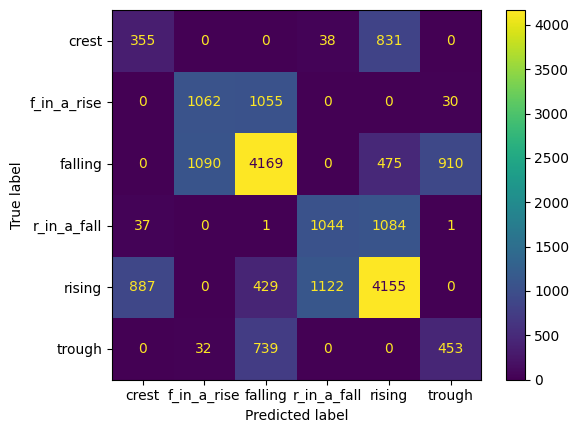

DecisionTree   Classifier report
               precision    recall  f1-score   support

       crest       0.28      0.29      0.28      1224
 f_in_a_rise       0.49      0.49      0.49      2147
     falling       0.65      0.63      0.64      6644
 r_in_a_fall       0.47      0.48      0.48      2167
      rising       0.63      0.63      0.63      6593
      trough       0.32      0.37      0.35      1224

    accuracy                           0.56     19999
   macro avg       0.47      0.48      0.48     19999
weighted avg       0.57      0.56      0.56     19999



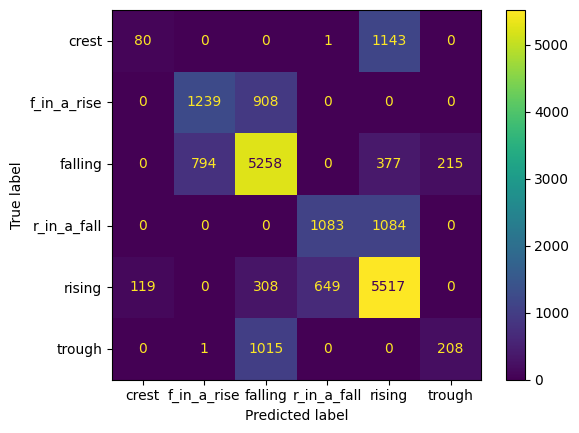

GradientBoosting Classifier report
               precision    recall  f1-score   support

       crest       0.40      0.07      0.11      1224
 f_in_a_rise       0.61      0.58      0.59      2147
     falling       0.70      0.79      0.74      6644
 r_in_a_fall       0.62      0.50      0.56      2167
      rising       0.68      0.84      0.75      6593
      trough       0.49      0.17      0.25      1224

    accuracy                           0.67     19999
   macro avg       0.58      0.49      0.50     19999
weighted avg       0.65      0.67      0.64     19999



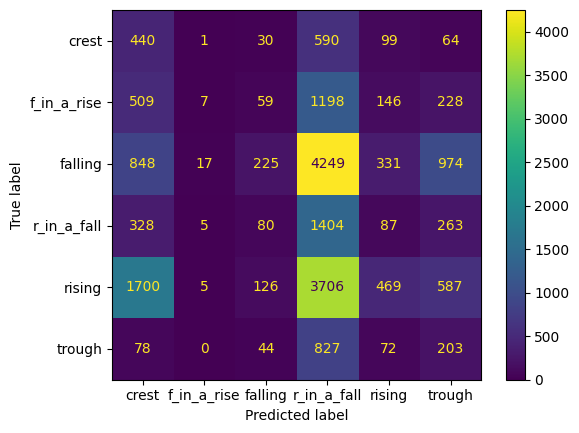

QuadraticDA Classifier report
               precision    recall  f1-score   support

       crest       0.11      0.36      0.17      1224
 f_in_a_rise       0.20      0.00      0.01      2147
     falling       0.40      0.03      0.06      6644
 r_in_a_fall       0.12      0.65      0.20      2167
      rising       0.39      0.07      0.12      6593
      trough       0.09      0.17      0.11      1224

    accuracy                           0.14     19999
   macro avg       0.22      0.21      0.11     19999
weighted avg       0.31      0.14      0.10     19999



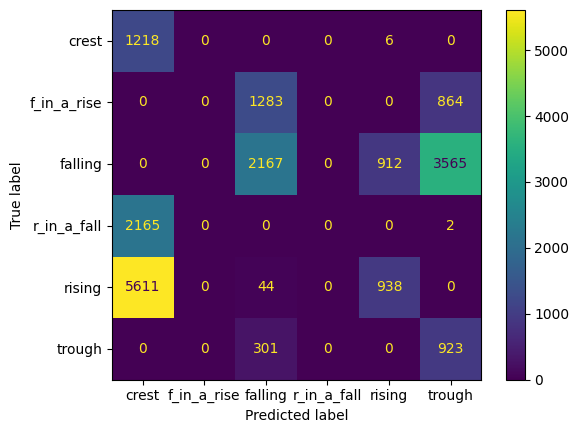

c:\Users\manch\OneDrive\Documents\DEV\MachineLearning\hands_On_Machine_Learning\lib\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

c:\Users\manch\OneDrive\Documents\DEV\MachineLearning\hands_On_Machine_Learning\lib\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

c:\Users\manch\OneDrive\Documents\DEV\MachineLearning\hands_On_Machine_Learning\lib\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



AdaBoost   Classifier report
               precision    recall  f1-score   support

       crest       0.14      1.00      0.24      1224
 f_in_a_rise       0.00      0.00      0.00      2147
     falling       0.57      0.33      0.42      6644
 r_in_a_fall       0.00      0.00      0.00      2167
      rising       0.51      0.14      0.22      6593
      trough       0.17      0.75      0.28      1224

    accuracy                           0.26     19999
   macro avg       0.23      0.37      0.19     19999
weighted avg       0.38      0.26      0.24     19999



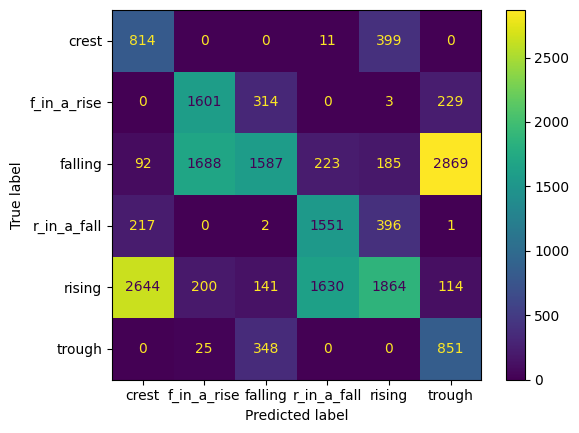

GaussianNB Classifier report
               precision    recall  f1-score   support

       crest       0.22      0.67      0.33      1224
 f_in_a_rise       0.46      0.75      0.57      2147
     falling       0.66      0.24      0.35      6644
 r_in_a_fall       0.45      0.72      0.56      2167
      rising       0.65      0.28      0.39      6593
      trough       0.21      0.70      0.32      1224

    accuracy                           0.41     19999
   macro avg       0.44      0.56      0.42     19999
weighted avg       0.56      0.41      0.41     19999



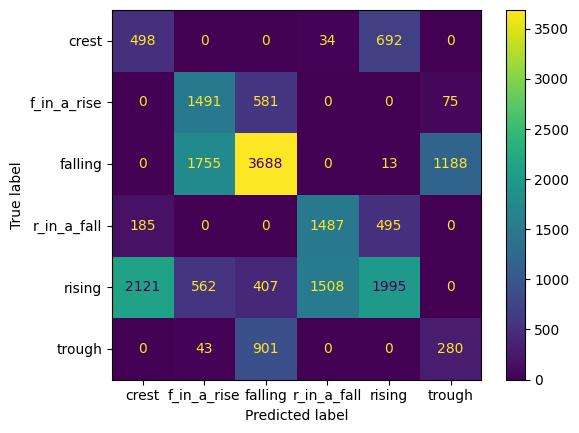

BernoulliNB Classifier report
               precision    recall  f1-score   support

       crest       0.18      0.41      0.25      1224
 f_in_a_rise       0.39      0.69      0.50      2147
     falling       0.66      0.56      0.60      6644
 r_in_a_fall       0.49      0.69      0.57      2167
      rising       0.62      0.30      0.41      6593
      trough       0.18      0.23      0.20      1224

    accuracy                           0.47     19999
   macro avg       0.42      0.48      0.42     19999
weighted avg       0.54      0.47      0.48     19999



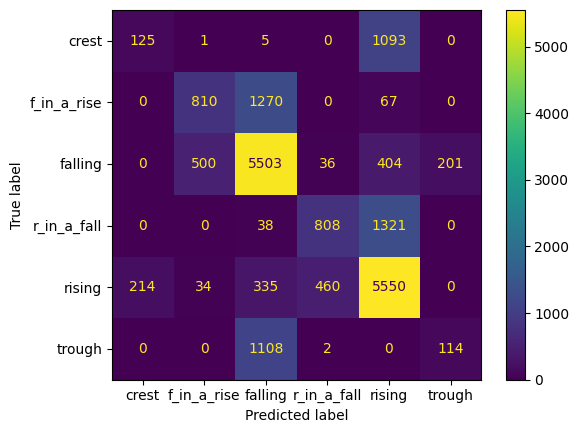

LinearDA Classifier report
               precision    recall  f1-score   support

       crest       0.37      0.10      0.16      1224
 f_in_a_rise       0.60      0.38      0.46      2147
     falling       0.67      0.83      0.74      6644
 r_in_a_fall       0.62      0.37      0.47      2167
      rising       0.66      0.84      0.74      6593
      trough       0.36      0.09      0.15      1224

    accuracy                           0.65     19999
   macro avg       0.55      0.44      0.45     19999
weighted avg       0.61      0.65      0.61     19999



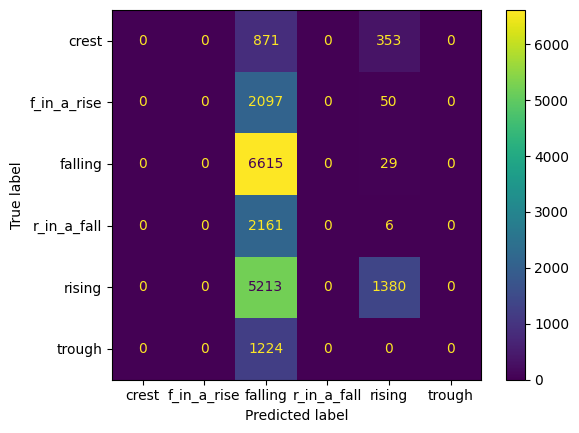

c:\Users\manch\OneDrive\Documents\DEV\MachineLearning\hands_On_Machine_Learning\lib\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

c:\Users\manch\OneDrive\Documents\DEV\MachineLearning\hands_On_Machine_Learning\lib\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

c:\Users\manch\OneDrive\Documents\DEV\MachineLearning\hands_On_Machine_Learning\lib\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



Perceptron Classifier report
               precision    recall  f1-score   support

       crest       0.00      0.00      0.00      1224
 f_in_a_rise       0.00      0.00      0.00      2147
     falling       0.36      1.00      0.53      6644
 r_in_a_fall       0.00      0.00      0.00      2167
      rising       0.76      0.21      0.33      6593
      trough       0.00      0.00      0.00      1224

    accuracy                           0.40     19999
   macro avg       0.19      0.20      0.14     19999
weighted avg       0.37      0.40      0.29     19999



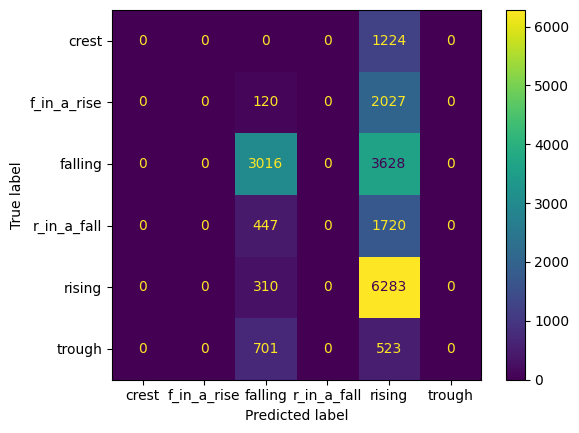

c:\Users\manch\OneDrive\Documents\DEV\MachineLearning\hands_On_Machine_Learning\lib\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



PassiveAG Classifier report
               precision    recall  f1-score   support

       crest       0.00      0.00      0.00      1224
 f_in_a_rise       0.00      0.00      0.00      2147
     falling       0.66      0.45      0.54      6644
 r_in_a_fall       0.00      0.00      0.00      2167
      rising       0.41      0.95      0.57      6593
      trough       0.00      0.00      0.00      1224

    accuracy                           0.46     19999
   macro avg       0.18      0.23      0.18     19999
weighted avg       0.35      0.46      0.37     19999



c:\Users\manch\OneDrive\Documents\DEV\MachineLearning\hands_On_Machine_Learning\lib\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

c:\Users\manch\OneDrive\Documents\DEV\MachineLearning\hands_On_Machine_Learning\lib\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



In [62]:
model_names=evaluation_df['Model']
for model in model_names:
    y_pred=classifiers[model].predict(X_test)
    ConfusionMatrixDisplay.from_predictions(y_test, y_pred)
    plt.show()
    print(f"{model} report\n",classification_report(y_pred=y_pred,y_true=y_test))

In [67]:
px.scatter(data_frame=dfMain,x='Slope Close',y='Slope MBand',color='Peak')

In [10]:
dfMain=data_frame(pair_name="dfUltimate_Moving Average Trends_STEP_2024_M1_9_3_14_20_28_99999.csv")
df=pd.DataFrame(data=dfMain)
df.loc[(df['Slope Close'] >0.000000001)     &   (df['Peak']=='falling'), 'Peak'] = 'r_in_a_fall'
df.loc[(df['Slope Close'] <-0.000000001 )   &    (df['Peak']=='rising'), 'Peak'] = 'f_in_a_rise'
df['MaUBand']=df['Ma']-df['UBand']
df['MaLBand']=df['Ma']-df['LBand']
df['MaMBand']=df['Ma']-df['MBand']
df['f1']=dfMain['Slope Close']+dfMain["Ma Close Diff"]
df['f2']=dfMain['Slope Ma Close diff']+dfMain['POIChange']
df['f3']=dfMain['diffsFromMid']+dfMain['Ma Close Diff']
y=df["Peak"]
X=df.copy()
X.pop('Trend Change')
X.pop('Slope Trend')
X.pop('Time Stamps')
X.pop('Instance')
X.pop("Peak")
scaler = StandardScaler()
X_svc =scaler.fit_transform(X.astype("float64"))
X_train, X_test, y_train, y_test = X[:80000], X[80000:], y[:80000], y[80000:]

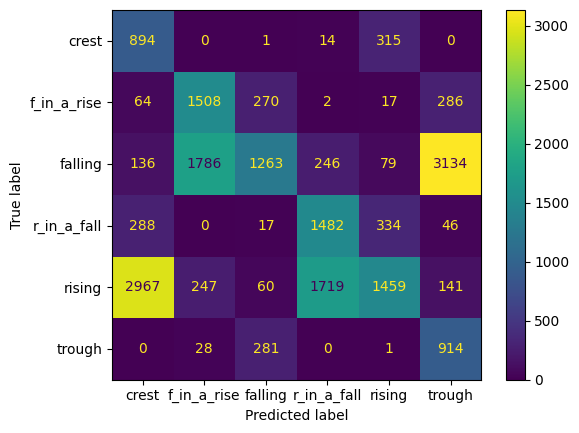

ADA Classification Report:
              precision    recall  f1-score   support

       crest       0.21      0.73      0.32      1224
 f_in_a_rise       0.42      0.70      0.53      2147
     falling       0.67      0.19      0.30      6644
 r_in_a_fall       0.43      0.68      0.53      2167
      rising       0.66      0.22      0.33      6593
      trough       0.20      0.75      0.32      1224

    accuracy                           0.38     19999
   macro avg       0.43      0.55      0.39     19999
weighted avg       0.56      0.38      0.36     19999



{'crest': {'precision': 0.20556449758565187,
  'recall': 0.7303921568627451,
  'f1-score': 0.3208325856809618,
  'support': 1224.0},
 'f_in_a_rise': {'precision': 0.4225273185766321,
  'recall': 0.7023754075454122,
  'f1-score': 0.5276417074877536,
  'support': 2147.0},
 'falling': {'precision': 0.6675475687103594,
  'recall': 0.19009632751354605,
  'f1-score': 0.29592314901593253,
  'support': 6644.0},
 'r_in_a_fall': {'precision': 0.4279526422177303,
  'recall': 0.683894785417628,
  'f1-score': 0.5264653641207815,
  'support': 2167.0},
 'rising': {'precision': 0.6616780045351474,
  'recall': 0.22129531321098134,
  'f1-score': 0.33166628779268015,
  'support': 6593.0},
 'trough': {'precision': 0.20216766202167663,
  'recall': 0.7467320261437909,
  'f1-score': 0.31818973020017405,
  'support': 1224.0},
 'accuracy': 0.376018800940047,
 'macro avg': {'precision': 0.43123961560786633,
  'recall': 0.5457976694490173,
  'f1-score': 0.3867864707163806,
  'support': 19999.0},
 'weighted avg':

In [12]:
metrics=['p', 'precomputed', 'cityblock', 'chebyshev', 'pyfunc', 'infinity', 'euclidean', 'mahalanobis', 'l1', 'correlation', 'russellrao', 'sokalsneath', 'minkowski', 'braycurtis', 'rogerstanimoto', 'sokalmichener', 'l2', 'cosine', 'hamming', 'dice', 'seuclidean', 'haversine', 'manhattan', 'nan_euclidean', 'sqeuclidean', 'jaccard', 'canberra', 'yule']
model = KNeighborsClassifier(n_neighbors=1,algorithm='ball_tree',weights='distance',leaf_size=100,metric=metrics[8],n_jobs=-1)
model11= Perceptron(penalty='elasticnet',alpha=0.00069,random_state=8)
model1 = SGDClassifier(loss='perceptron',penalty='l2')
model2 = PassiveAggressiveClassifier(random_state=420)
model3 = AdaBoostClassifier(RandomForestClassifier(max_depth=1), n_estimators=30,learning_rate=0.05, random_state=42)
model4 = AdaBoostClassifier(DecisionTreeClassifier(max_depth=5), n_estimators=50,learning_rate=0.001, random_state=37)
model5 = AdaBoostClassifier(ExtraTreesClassifier(max_depth=5), n_estimators=30,learning_rate=0.05, random_state=42)
model6 = PassiveAggressiveClassifier(random_state=890907)
model7 = ExtraTreesClassifier(random_state=67)
model8 = BernoulliNB()
model9 = GaussianNB()
voting_clf = VotingClassifier(
 estimators=[
 ('bag_clf',model9),
 ('moedl1',model8),
 ('pag',model2)
# ('sgd_clf',SGDClassifier(loss='hinge',penalty='l1')),
 #('ada_clf',  AdaBoostClassifier(ExtraTreesClassifier(max_depth=5),n_estimators=30,learning_rate=0.5, random_state=42)),

 #('hist_clf', HistGradientBoostingClassifier(max_depth=6,learning_rate=0.05, random_state=9))
 ]
)
train_and_Evaluate(model=model9,x1=X_train,y1=y_train,x2=X_test,y2=y_test)


In [26]:
dfMain=data_frame(pair_name="dfUltimate_Moving Average Trends_STEP_2024_M1_9_3_14_20_28_99999.csv")
dfMain['f1']=dfMain['Slope Close']+dfMain["Ma Close Diff"]
dfMain['f2']=dfMain['Slope Ma Close diff']+dfMain['POIChange']
dfMain['f3']=dfMain['diffsFromMid']+dfMain['Ma Close Diff']
import plotly.express as px
px.scatter_3d(data_frame=dfMain,x='f1',y='f2',z='f3',color='Peak')




In [24]:
px.scatter_3d(data_frame=dfMain,x='Slope Close',y='RSI',z='diffsFromMid',color='Peak')

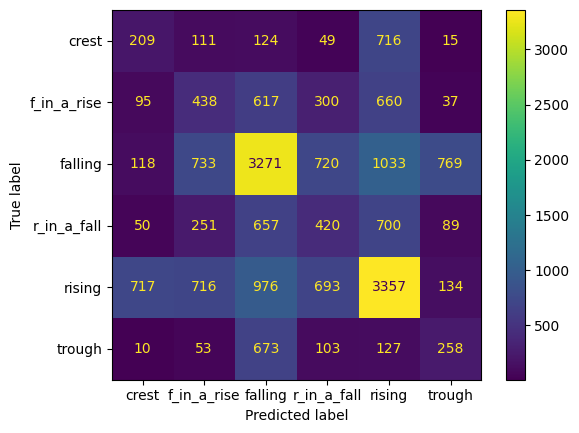

ADA Classification Report:
              precision    recall  f1-score   support

       crest       0.17      0.17      0.17      1224
 f_in_a_rise       0.19      0.20      0.20      2147
     falling       0.52      0.49      0.50      6644
 r_in_a_fall       0.18      0.19      0.19      2167
      rising       0.51      0.51      0.51      6593
      trough       0.20      0.21      0.20      1224

    accuracy                           0.40     19999
   macro avg       0.30      0.30      0.30     19999
weighted avg       0.40      0.40      0.40     19999



{'crest': {'precision': 0.1743119266055046,
  'recall': 0.1707516339869281,
  'f1-score': 0.17251341312422616,
  'support': 1224.0},
 'f_in_a_rise': {'precision': 0.1902693310165074,
  'recall': 0.2040055891942245,
  'f1-score': 0.1968981793661497,
  'support': 2147.0},
 'falling': {'precision': 0.5177271288382399,
  'recall': 0.4923239012642986,
  'f1-score': 0.504706063879031,
  'support': 6644.0},
 'r_in_a_fall': {'precision': 0.1838074398249453,
  'recall': 0.19381633594831565,
  'f1-score': 0.18867924528301888,
  'support': 2167.0},
 'rising': {'precision': 0.5091763992112847,
  'recall': 0.5091763992112847,
  'f1-score': 0.5091763992112847,
  'support': 6593.0},
 'trough': {'precision': 0.19815668202764977,
  'recall': 0.2107843137254902,
  'f1-score': 0.2042755344418052,
  'support': 1224.0},
 'accuracy': 0.3976698834941747,
 'macro avg': {'precision': 0.29557481792068857,
  'recall': 0.29680969555509024,
  'f1-score': 0.2960414725509192,
  'support': 19999.0},
 'weighted avg': 

In [64]:
train_and_Evaluate(model=model,x1=X_train,y1=y_train,x2=X_test,y2=y_test)